In [5]:
# @title Download the data

import os, requests, tarfile

fnames = ["kay_labels.npy", "kay_labels_val.npy", "kay_images.npz"]
urls = ["https://osf.io/r638s/download",
        "https://osf.io/yqb3e/download",
        "https://osf.io/ymnjv/download"]

for fname, url in zip(fnames, urls):
  if not os.path.isfile(fname):
    try:
      r = requests.get(url)
    except requests.ConnectionError:
      print("!!! Failed to download data !!!")
    else:
      if r.status_code != requests.codes.ok:
        print("!!! Failed to download data !!!")
      else:
        print(f"Downloading {fname}...")
        with open(fname, "wb") as fid:
          fid.write(r.content)
        print(f"Download {fname} completed!")

Download kay_labels.npy completed!
Download kay_labels_val.npy completed!
Download kay_images.npz completed!


In [13]:
# @title Initialize Hmax S1-C1 Layer model

import numpy as np
from scipy.io import loadmat
import torch
from torch import nn


def gabor_filter(size, wavelength, orientation):
    """Create a single gabor filter.

    Parameters
    ----------
    size : int
        The size of the filter, measured in pixels. The filter is square, hence
        only a single number (either width or height) needs to be specified.
    wavelength : float
        The wavelength of the grating in the filter, relative to the half the
        size of the filter. For example, a wavelength of 2 will generate a
        Gabor filter with a grating that contains exactly one wave. This
        determines the "tightness" of the filter.
    orientation : float
        The orientation of the grating in the filter, in degrees.

    Returns
    -------
    filt : ndarray, shape (size, size)
        The filter weights.
    """
    lambda_ = size * 2. / wavelength
    sigma = lambda_ * 0.8
    gamma = 0.3  # spatial aspect ratio: 0.23 < gamma < 0.92
    theta = np.deg2rad(orientation + 90)

    # Generate Gabor filter
    x, y = np.mgrid[:size, :size] - (size // 2)
    rotx = x * np.cos(theta) + y * np.sin(theta)
    roty = -x * np.sin(theta) + y * np.cos(theta)
    filt = np.exp(-(rotx**2 + gamma**2 * roty**2) / (2 * sigma ** 2))
    filt *= np.cos(2 * np.pi * rotx / lambda_)
    filt[np.sqrt(x**2 + y**2) > (size / 2)] = 0

    # Normalize the filter
    filt = filt - np.mean(filt)
    filt = filt / np.sqrt(np.sum(filt ** 2))

    return filt


class S1(nn.Module):
    """A layer of S1 units with different orientations but the same scale.

    The S1 units are at the bottom of the network. They are exposed to the raw
    pixel data of the image. Each S1 unit is a Gabor filter, which detects
    edges in a certain orientation. They are implemented as PyTorch Conv2d
    modules, where each channel is loaded with a Gabor filter in a specific
    orientation.

    Parameters
    ----------
    size : int
        The size of the filters, measured in pixels. The filters are square,
        hence only a single number (either width or height) needs to be
        specified.
    wavelength : float
        The wavelength of the grating in the filter, relative to the half the
        size of the filter. For example, a wavelength of 2 will generate a
        Gabor filter with a grating that contains exactly one wave. This
        determines the "tightness" of the filter.
    orientations : list of float
        The orientations of the Gabor filters, in degrees.
    """
    def __init__(self, size, wavelength, orientations=[90, -45, 0, 45]):
        super().__init__()
        self.num_orientations = len(orientations)
        self.size = size

        # Use PyTorch's Conv2d as a base object. Each "channel" will be an
        # orientation.
        self.gabor = nn.Conv2d(1, self.num_orientations, size,
                               padding='same', bias=False)

        # The original HMAX code has a rather unique approach to padding during
        # convolution. First, the convolution is performed with padding='same',
        # and then the borders of the result are replaced with zeros. The
        # computation of the border width is as follows:
        self.padding_left = (size + 1) // 2
        self.padding_right = (size - 1) // 2
        self.padding_top = (size + 1) // 2
        self.padding_bottom = (size - 1) // 2

        # Fill the Conv2d filter weights with Gabor kernels: one for each
        # orientation
        for channel, orientation in enumerate(orientations):
            self.gabor.weight.data[channel, 0] = torch.Tensor(
                gabor_filter(size, wavelength, orientation))

        # A convolution layer filled with ones. This is used to normalize the
        # result in the forward method.
        self.uniform = nn.Conv2d(1, 4, size, padding=size // 2, bias=False)
        nn.init.constant_(self.uniform.weight, 1)

        # Since everything is pre-computed, no gradient is required
        for p in self.parameters():
            p.requires_grad = False

    def forward(self, img):
        """Apply Gabor filters, take absolute value, and normalize."""
        s1_output = torch.abs(self.gabor(img))
        s1_output[:, :, :, :self.padding_left] = 0
        s1_output[:, :, :, -self.padding_right:] = 0
        s1_output[:, :, :self.padding_top, :] = 0
        s1_output[:, :, -self.padding_bottom:, :] = 0
        norm = torch.sqrt(self.uniform(img ** 2))
        norm.data[norm == 0] = 1  # To avoid divide by zero
        s1_output /= norm
        return s1_output


class C1(nn.Module):
    """A layer of C1 units with different orientations but the same scale.

    Each C1 unit pools over the S1 units that are assigned to it.

    Parameters
    ----------
    size : int
        Size of the MaxPool2d operation being performed by this C1 layer.
    """
    def __init__(self, size):
        super().__init__()
        self.size = size
        self.local_pool = nn.MaxPool2d(size, stride=size // 2,
                                       padding=size // 2)

        # Since everything is pre-computed, no gradient is required
        for p in self.parameters():
            p.requires_grad = False

    def forward(self, s1_outputs):
        """Max over scales, followed by a MaxPool2d operation."""
        s1_outputs = torch.cat([out.unsqueeze(0) for out in s1_outputs], 0)

        # Pool over all scales
        s1_output, _ = torch.max(s1_outputs, dim=0)

        # Pool over local (c1_space x c1_space) neighbourhood
        c1_output = self.local_pool(s1_output)

        # We need to shift the output after the convolution by 1 pixel to
        # exactly match the wonky MATLAB implementation.
        c1_output = torch.roll(c1_output, (-1, -1), dims=(2, 3))
        c1_output[:, :, -1, :] = 0
        c1_output[:, :, :, -1] = 0

        return c1_output


class S2(nn.Module):
    """A layer of S2 units with different orientations but the same scale.

    The activation of these units is computed by taking the distance between
    the output of the C layer below and a set of predefined patches. This
    distance is computed as:

      d = sqrt( (w - p)^2 )
        = sqrt( w^2 - 2pw + p^2 )

    Parameters
    ----------
    patches : ndarray, shape (n_patches, n_orientations, size, size)
        The precomputed patches to lead into the weights of this layer.
    activation : 'gaussian' | 'euclidean'
        Which activation function to use for the units. In the PNAS paper, a
        gaussian curve is used ('guassian', the default), whereas the MATLAB
        implementation of The Laboratory for Computational Cognitive
        Neuroscience uses the euclidean distance ('euclidean').
    sigma : float
        The sharpness of the tuning (sigma in eqn 1 of [1]_). Defaults to 1.
        Only used when using gaussian activation.

    References:
    -----------

    .. [1] Serre, Thomas, Aude Oliva, and Tomaso Poggio. “A Feedforward
           Architecture Accounts for Rapid Categorization.” Proceedings of the
           National Academy of Sciences 104, no. 15 (April 10, 2007): 6424–29.
           https://doi.org/10.1073/pnas.0700622104.
    """
    def __init__(self, patches, activation='euclidean', sigma=1):
        super().__init__()
        self.activation = activation
        self.sigma = sigma

        num_patches, num_orientations, size, _ = patches.shape

        # Main convolution layer
        self.conv = nn.Conv2d(in_channels=num_orientations,
                              out_channels=num_orientations * num_patches,
                              kernel_size=size,
                              padding=size // 2,
                              groups=num_orientations,
                              bias=False)
        self.conv.weight.data = torch.Tensor(
            patches.transpose(1, 0, 2, 3).reshape(num_orientations * num_patches,
                                                  1, size, size))

        # A convolution layer filled with ones. This is used for the distance
        # computation
        self.uniform = nn.Conv2d(1, 1, size, padding=size // 2, bias=False)
        nn.init.constant_(self.uniform.weight, 1)

        # This is also used for the distance computation
        self.patches_sum_sq = nn.Parameter(
            torch.Tensor((patches ** 2).sum(axis=(1, 2, 3))))

        self.num_patches = num_patches
        self.num_orientations = num_orientations
        self.size = size

        # No gradient required for this layer
        for p in self.parameters():
            p.requires_grad = False

    def forward(self, c1_outputs):
        s2_outputs = []
        for c1_output in c1_outputs:
            conv_output = self.conv(c1_output)
            conv_output = conv_output[:, :, 1:, 1:]

            # Unstack the orientations
            conv_output_size = conv_output.shape[3]
            conv_output = conv_output.view(
                -1, self.num_orientations, self.num_patches, conv_output_size,
                conv_output_size)

            # Pool over orientations
            conv_output = conv_output.sum(dim=1)

            # Compute distance
            c1_sq = self.uniform(
                torch.sum(c1_output ** 2, dim=1, keepdim=True))
            c1_sq = c1_sq[:, :, 1:, 1:]
            dist = c1_sq - 2 * conv_output
            dist += self.patches_sum_sq[None, :, None, None]

            # Apply activation function
            if self.activation == 'gaussian':
                dist = torch.exp(- 1 / (2 * self.sigma ** 2) * dist)
            elif self.activation == 'euclidean':
                dist[dist < 0] = 0  # Negative values should never occur
                torch.sqrt_(dist)
            else:
                raise ValueError("activation parameter should be either "
                                 "'gaussian' or 'euclidean'.")

            s2_outputs.append(dist)
        return s2_outputs


class C2(nn.Module):
    """A layer of C2 units operating on a layer of S2 units."""
    def forward(self, s2_outputs):
        """Take the minimum value of the underlying S2 units."""
        mins = [s2.min(dim=3)[0] for s2 in s2_outputs]
        mins = [m.min(dim=2)[0] for m in mins]
        mins = torch.cat([m[:, None, :] for m in mins], 1)
        return mins.min(dim=1)[0]


class HMAX(nn.Module):
    """The full HMAX model.

    Use the `get_all_layers` method to obtain the activations for all layers.

    If you are only interested in the final output (=C2 layer), use the model
    as any other PyTorch module:

        model = HMAX(universal_patch_set)
        output = model(img)

    Parameters
    ----------
    universal_patch_set : str
        Filename of the .mat file containing the universal patch set.
    s2_act : 'gaussian' | 'euclidean'
        The activation function for the S2 units. Defaults to 'euclidean'.

    Returns
    -------
    c2_output : list of Tensors, shape (batch_size, num_patches)
        For each scale, the output of the C2 units.
    """
    def __init__(self, universal_patch_set, s2_act='euclidean'):
        super().__init__()

        # S1 layers, consisting of units with increasing size
        self.s1_units = [
            S1(size=7, wavelength=4),
            S1(size=9, wavelength=3.95),
            S1(size=11, wavelength=3.9),
            S1(size=13, wavelength=3.85),
            S1(size=15, wavelength=3.8),
            S1(size=17, wavelength=3.75),
            S1(size=19, wavelength=3.7),
            S1(size=21, wavelength=3.65),
            S1(size=23, wavelength=3.6),
            S1(size=25, wavelength=3.55),
            S1(size=27, wavelength=3.5),
            S1(size=29, wavelength=3.45),
            S1(size=31, wavelength=3.4),
            S1(size=33, wavelength=3.35),
            S1(size=35, wavelength=3.3),
            S1(size=37, wavelength=3.25),
            S1(size=39, wavelength=3.20),
        ]

        for s1 in self.s1_units:
            self.add_module('s1_%02d' % s1.size, s1)

        self.c1_units = [
            C1(size=8),
            C1(size=10),
            C1(size=12),
            C1(size=14),
            C1(size=16),
            C1(size=18),
            C1(size=20),
            C1(size=22),
        ]

        for c1 in self.c1_units:
            self.add_module('c1_%02d' % c1.size, c1)

        m = loadmat(universal_patch_set)
        patches = [patch.reshape(shape[[2, 1, 0, 3]]).transpose(3, 0, 2, 1)
                   for patch, shape in zip(m['patches'][0], m['patchSizes'].T)]

        self.s2_units = [S2(patches=scale_patches, activation=s2_act)
                         for scale_patches in patches]

        for i, s2 in enumerate(self.s2_units):
            self.add_module('s2_%d' % i, s2)

        self.c2_units = [C2() for s2 in self.s2_units]

        for i, c2 in enumerate(self.c2_units):
            self.add_module('c2_%d' % i, c2)

    def run_all_layers(self, img):
        """Compute the activation for each layer.

        Parameters
        ----------
        img : Tensor, shape (batch_size, 1, height, width)
            A batch of images to run through the model

        Returns
        -------
        s1_outputs : List of Tensors, shape (batch_size, num_orientations, height, width)
            For each scale, the output of the layer of S1 units.
        c1_outputs : List of Tensors, shape (batch_size, num_orientations, height, width)
            For each scale, the output of the layer of C1 units.
        s2_outputs : List of lists of Tensors, shape (batch_size, num_patches, height, width)
            For each C1 scale and each patch scale, the output of the layer of
            S2 units.
        c2_outputs : List of Tensors, shape (batch_size, num_patches)
            For each patch scale, the output of the layer of C2 units.
        """  # noqa
        s1_outputs = [s1(img) for s1 in self.s1_units]

        c1_outputs = []
        for c1, i in zip(self.c1_units, range(0, len(self.s1_units), 2)):
            c1_outputs.append(c1(s1_outputs[i:i+2]))


        return s1_outputs, c1_outputs

    def forward(self, img):
        """Run through everything and concatenate the output of the C2s."""
        c2_outputs = self.run_all_layers(img)[-1]
        c2_outputs = torch.cat(
            [c2_out[:, None, :] for c2_out in c2_outputs], 1)
        return c2_outputs

    def get_all_layers(self, img):
        """Get the activation for all layers as NumPy arrays.

        Parameters
        ----------
        img : Tensor, shape (batch_size, 1, height, width)
            A batch of images to run through the model

        Returns
        -------
        s1_outputs : List of arrays, shape (batch_size, num_orientations, height, width)
            For each scale, the output of the layer of S1 units.
        c1_outputs : List of arrays, shape (batch_size, num_orientations, height, width)
            For each scale, the output of the layer of C1 units.
        s2_outputs : List of lists of arrays, shape (batch_size, num_patches, height, width)
            For each C1 scale and each patch scale, the output of the layer of
            S2 units.
        c2_outputs : List of arrays, shape (batch_size, num_patches)
            For each patch scale, the output of the layer of C2 units.
        """  # noqa
        s1_out, c1_out = self.run_all_layers(img)
        return (
            [s1.cpu().detach().numpy() for s1 in s1_out],
            [c1.cpu().detach().numpy() for c1 in c1_out],
        )

In [14]:
with np.load(fname) as dobj:
  dat = dict(**dobj)
labels = np.load('kay_labels.npy')
val_labels = np.load('kay_labels_val.npy')

In [78]:
stimuli = dat['stimuli']
responses = dat['responses']
roi = dat['roi']
roi_names = dat['roi_names']
stimuli_test = dat['stimuli_test']
responses_test = dat['responses_test']
X_train=stimuli

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Constructing model
Running model on cpu
Image shape: (128, 128)
C1 Activation shape (before resize): (19, 19)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (19, 19)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (19, 19)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (19, 19)
C1 Activation shape (after resize): (128, 128)


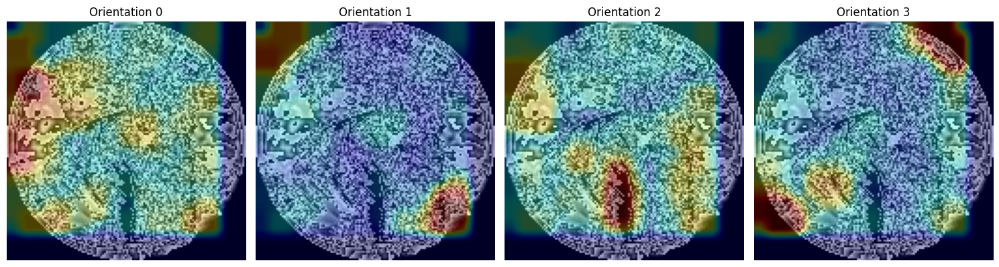

<Figure size 640x480 with 0 Axes>

Image shape: (128, 128)
C1 Activation shape (before resize): (17, 17)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (17, 17)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (17, 17)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (17, 17)
C1 Activation shape (after resize): (128, 128)


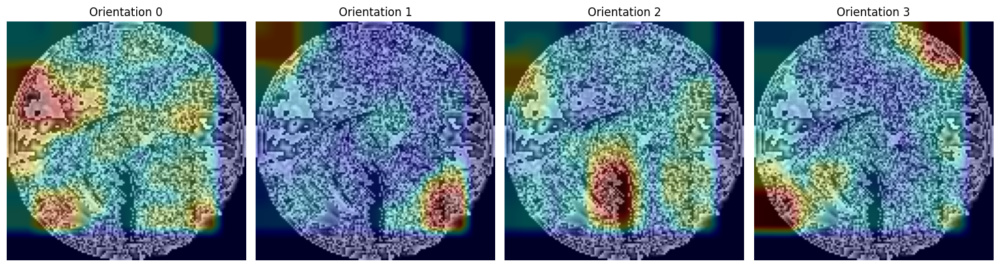

<Figure size 640x480 with 0 Axes>

Image shape: (128, 128)
C1 Activation shape (before resize): (15, 15)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (15, 15)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (15, 15)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (15, 15)
C1 Activation shape (after resize): (128, 128)


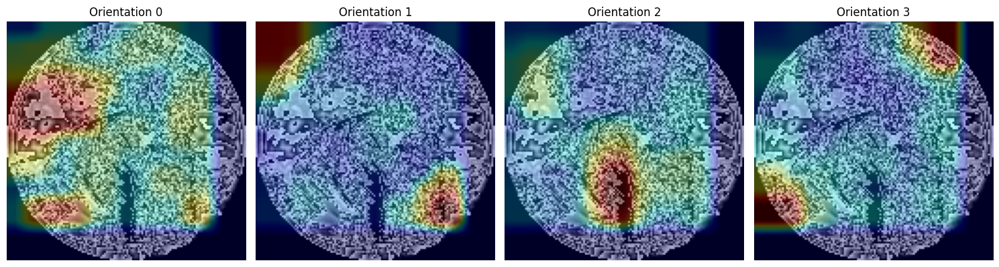

<Figure size 640x480 with 0 Axes>

Image shape: (128, 128)
C1 Activation shape (before resize): (19, 19)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (19, 19)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (19, 19)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (19, 19)
C1 Activation shape (after resize): (128, 128)


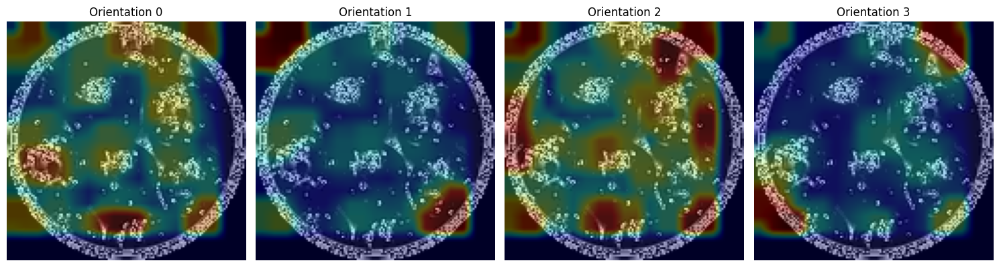

<Figure size 640x480 with 0 Axes>

Image shape: (128, 128)
C1 Activation shape (before resize): (17, 17)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (17, 17)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (17, 17)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (17, 17)
C1 Activation shape (after resize): (128, 128)


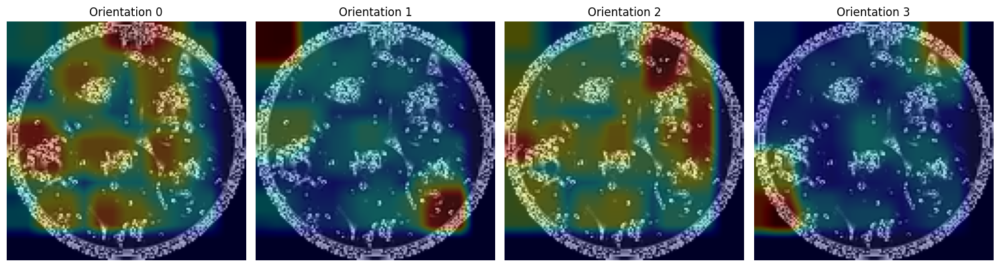

<Figure size 640x480 with 0 Axes>

Image shape: (128, 128)
C1 Activation shape (before resize): (15, 15)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (15, 15)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (15, 15)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (15, 15)
C1 Activation shape (after resize): (128, 128)


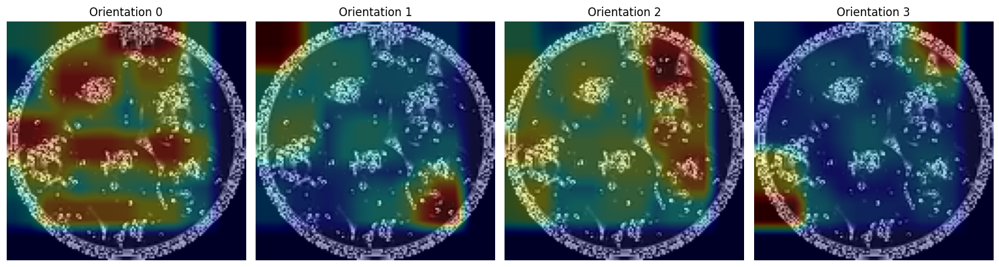

<Figure size 640x480 with 0 Axes>

Image shape: (128, 128)
C1 Activation shape (before resize): (19, 19)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (19, 19)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (19, 19)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (19, 19)
C1 Activation shape (after resize): (128, 128)


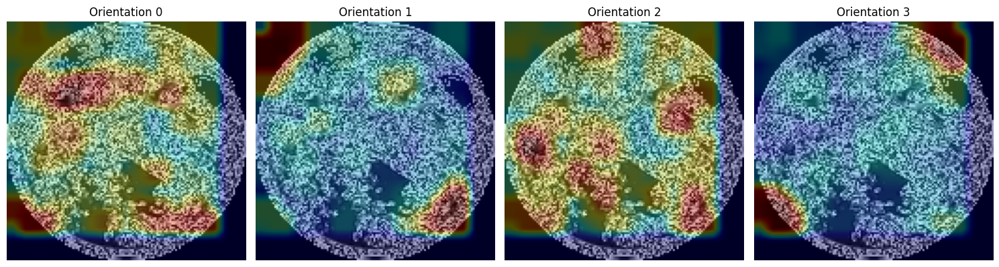

<Figure size 640x480 with 0 Axes>

Image shape: (128, 128)
C1 Activation shape (before resize): (17, 17)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (17, 17)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (17, 17)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (17, 17)
C1 Activation shape (after resize): (128, 128)


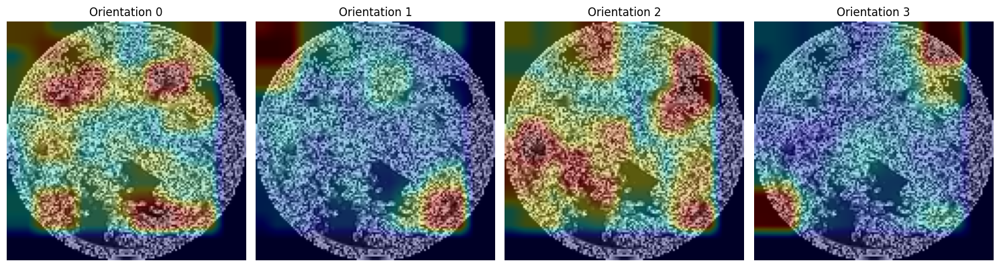

<Figure size 640x480 with 0 Axes>

Image shape: (128, 128)
C1 Activation shape (before resize): (15, 15)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (15, 15)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (15, 15)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (15, 15)
C1 Activation shape (after resize): (128, 128)


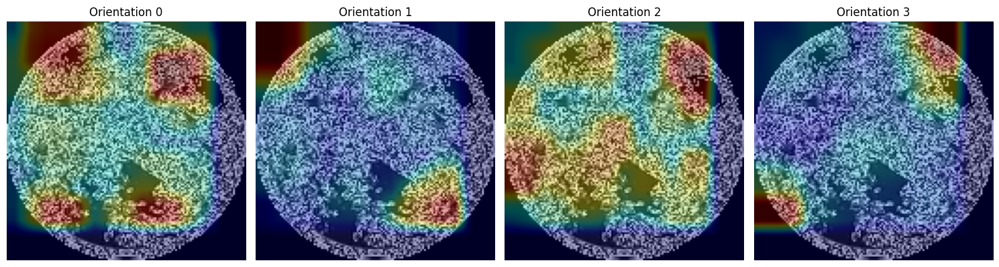

<Figure size 640x480 with 0 Axes>

Image shape: (128, 128)
C1 Activation shape (before resize): (19, 19)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (19, 19)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (19, 19)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (19, 19)
C1 Activation shape (after resize): (128, 128)


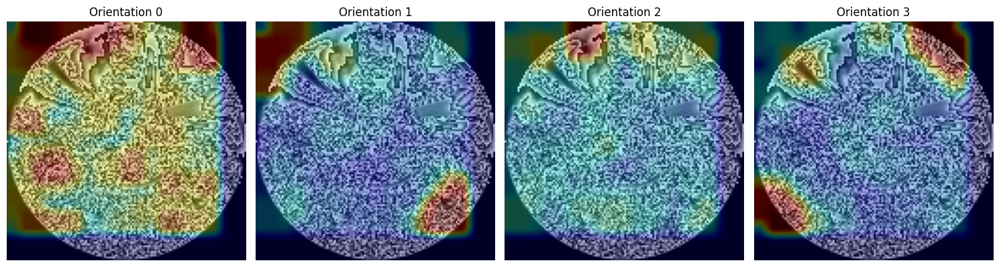

<Figure size 640x480 with 0 Axes>

Image shape: (128, 128)
C1 Activation shape (before resize): (17, 17)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (17, 17)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (17, 17)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (17, 17)
C1 Activation shape (after resize): (128, 128)


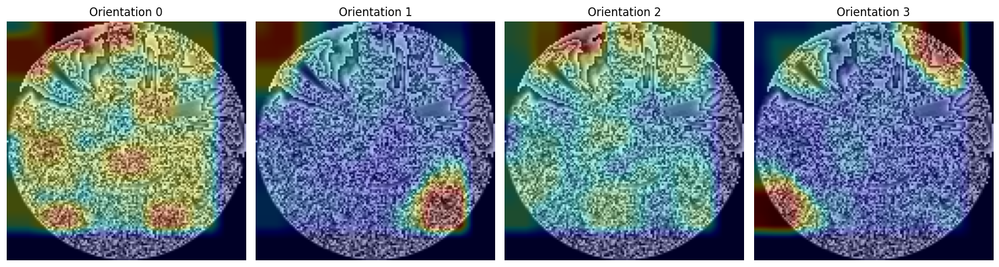

<Figure size 640x480 with 0 Axes>

Image shape: (128, 128)
C1 Activation shape (before resize): (15, 15)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (15, 15)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (15, 15)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (15, 15)
C1 Activation shape (after resize): (128, 128)


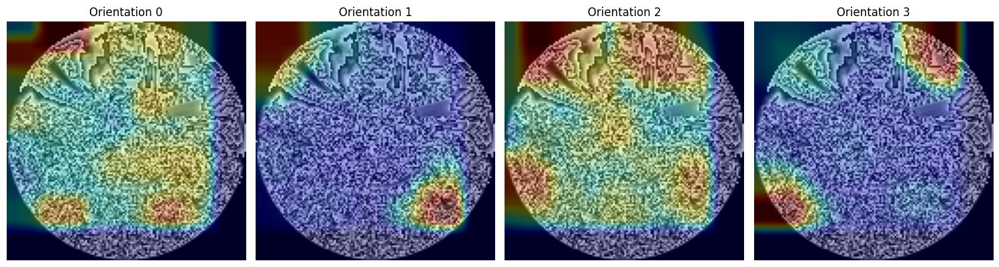

<Figure size 640x480 with 0 Axes>

Image shape: (128, 128)
C1 Activation shape (before resize): (19, 19)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (19, 19)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (19, 19)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (19, 19)
C1 Activation shape (after resize): (128, 128)


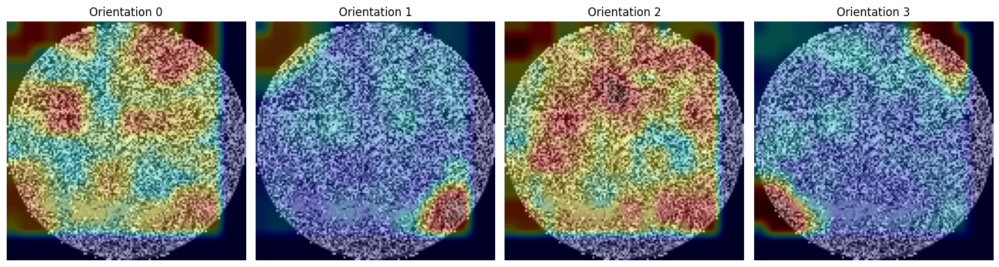

<Figure size 640x480 with 0 Axes>

Image shape: (128, 128)
C1 Activation shape (before resize): (17, 17)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (17, 17)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (17, 17)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (17, 17)
C1 Activation shape (after resize): (128, 128)


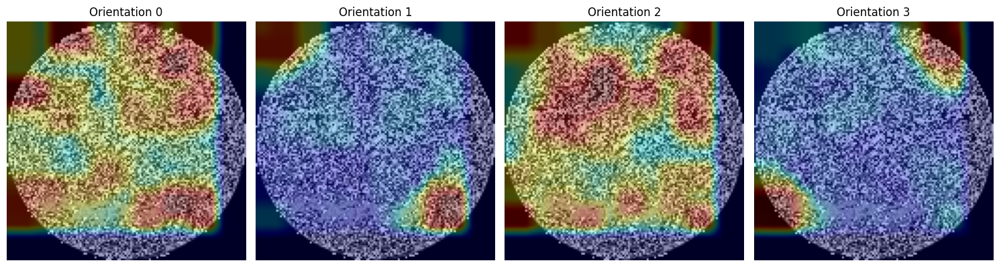

<Figure size 640x480 with 0 Axes>

Image shape: (128, 128)
C1 Activation shape (before resize): (15, 15)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (15, 15)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (15, 15)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (15, 15)
C1 Activation shape (after resize): (128, 128)


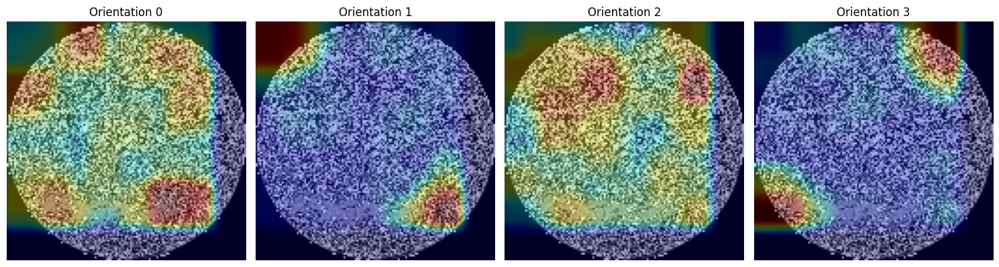

<Figure size 640x480 with 0 Axes>

Image shape: (128, 128)
C1 Activation shape (before resize): (19, 19)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (19, 19)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (19, 19)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (19, 19)
C1 Activation shape (after resize): (128, 128)


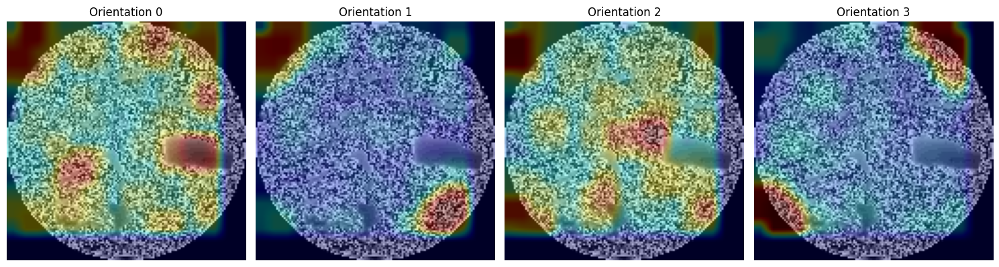

<Figure size 640x480 with 0 Axes>

Image shape: (128, 128)
C1 Activation shape (before resize): (17, 17)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (17, 17)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (17, 17)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (17, 17)
C1 Activation shape (after resize): (128, 128)


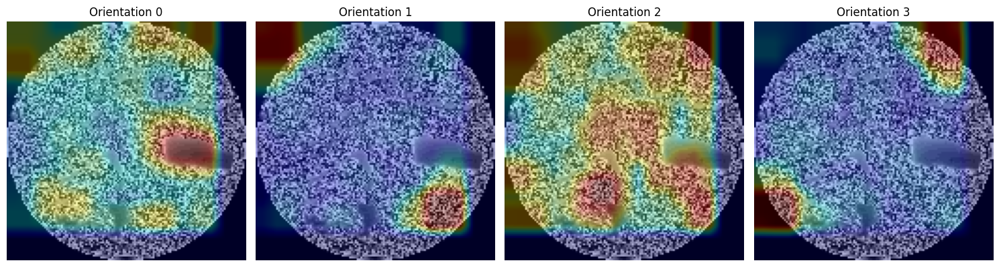

<Figure size 640x480 with 0 Axes>

Image shape: (128, 128)
C1 Activation shape (before resize): (15, 15)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (15, 15)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (15, 15)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (15, 15)
C1 Activation shape (after resize): (128, 128)


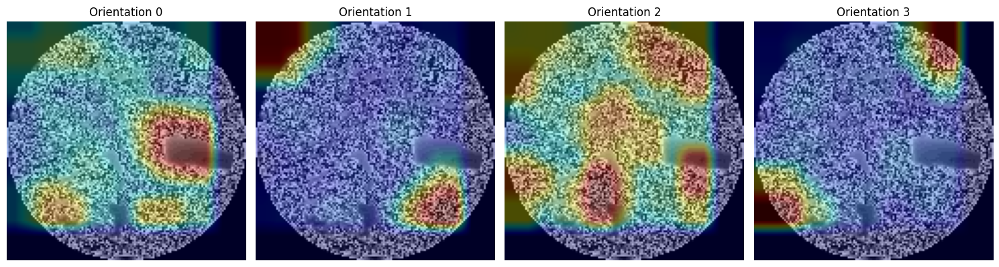

<Figure size 640x480 with 0 Axes>

Image shape: (128, 128)
C1 Activation shape (before resize): (19, 19)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (19, 19)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (19, 19)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (19, 19)
C1 Activation shape (after resize): (128, 128)


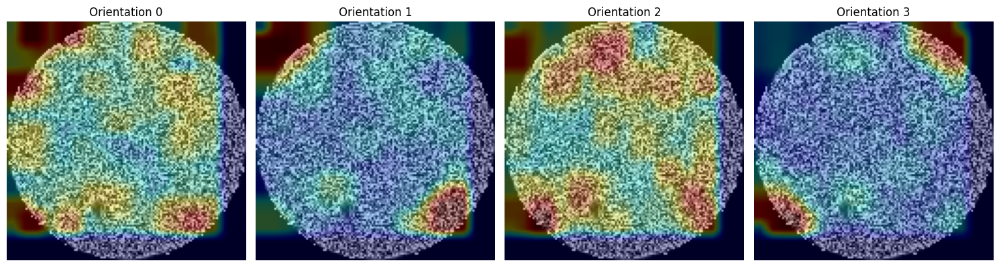

<Figure size 640x480 with 0 Axes>

Image shape: (128, 128)
C1 Activation shape (before resize): (17, 17)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (17, 17)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (17, 17)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (17, 17)
C1 Activation shape (after resize): (128, 128)


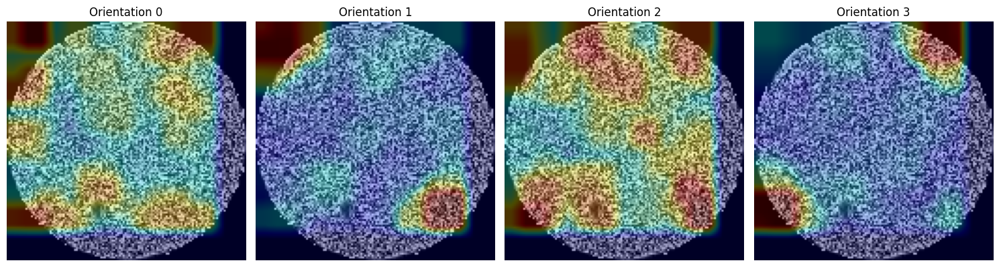

<Figure size 640x480 with 0 Axes>

Image shape: (128, 128)
C1 Activation shape (before resize): (15, 15)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (15, 15)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (15, 15)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (15, 15)
C1 Activation shape (after resize): (128, 128)


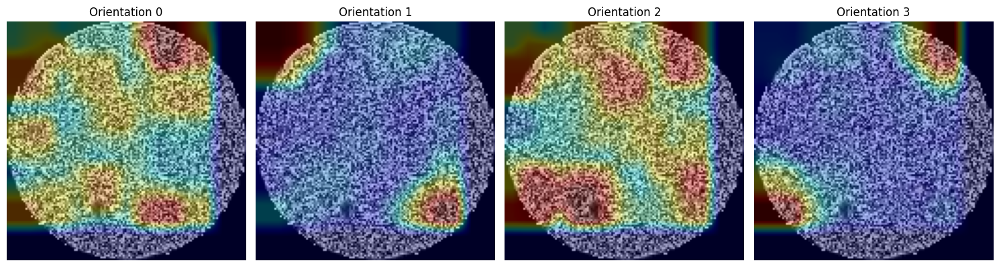

<Figure size 640x480 with 0 Axes>

Image shape: (128, 128)
C1 Activation shape (before resize): (19, 19)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (19, 19)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (19, 19)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (19, 19)
C1 Activation shape (after resize): (128, 128)


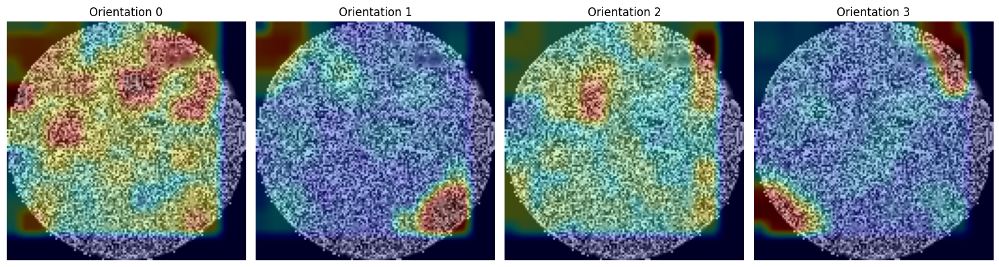

<Figure size 640x480 with 0 Axes>

Image shape: (128, 128)
C1 Activation shape (before resize): (17, 17)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (17, 17)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (17, 17)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (17, 17)
C1 Activation shape (after resize): (128, 128)


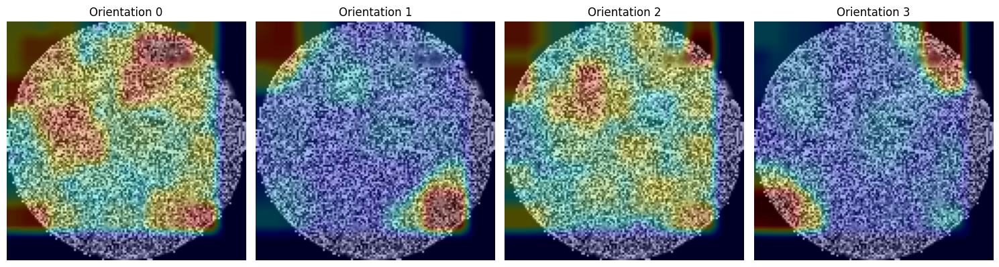

<Figure size 640x480 with 0 Axes>

Image shape: (128, 128)
C1 Activation shape (before resize): (15, 15)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (15, 15)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (15, 15)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (15, 15)
C1 Activation shape (after resize): (128, 128)


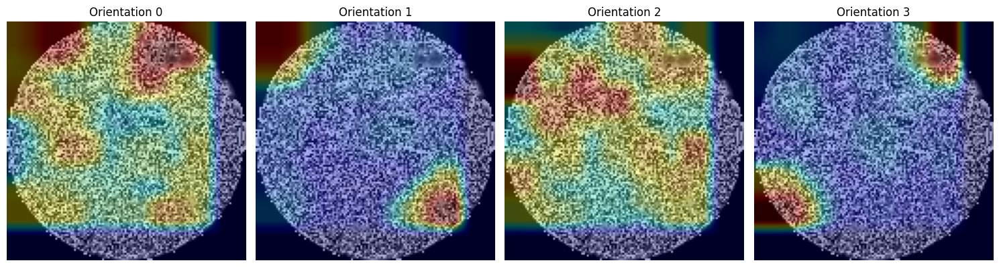

<Figure size 640x480 with 0 Axes>

Image shape: (128, 128)
C1 Activation shape (before resize): (19, 19)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (19, 19)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (19, 19)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (19, 19)
C1 Activation shape (after resize): (128, 128)


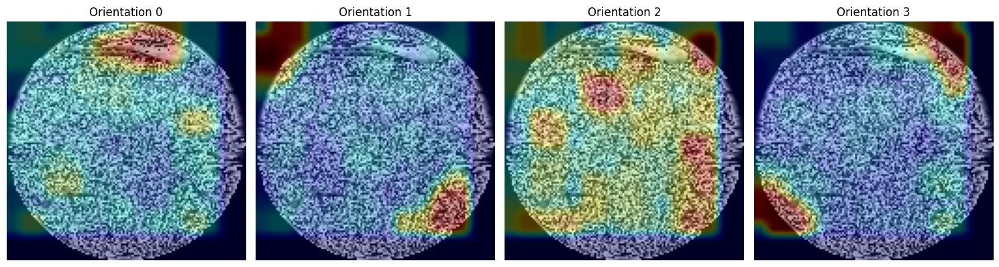

<Figure size 640x480 with 0 Axes>

Image shape: (128, 128)
C1 Activation shape (before resize): (17, 17)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (17, 17)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (17, 17)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (17, 17)
C1 Activation shape (after resize): (128, 128)


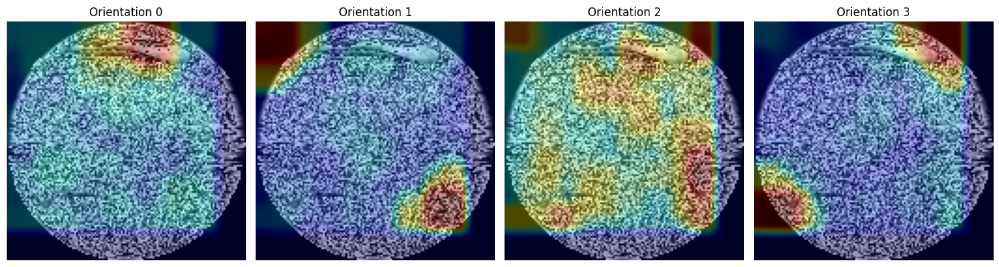

<Figure size 640x480 with 0 Axes>

Image shape: (128, 128)
C1 Activation shape (before resize): (15, 15)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (15, 15)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (15, 15)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (15, 15)
C1 Activation shape (after resize): (128, 128)


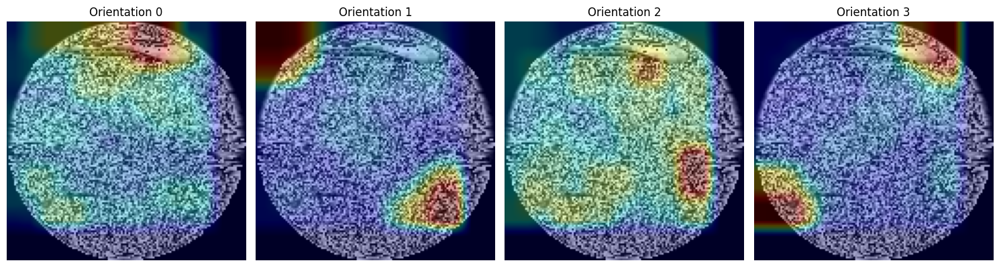

<Figure size 640x480 with 0 Axes>

Image shape: (128, 128)
C1 Activation shape (before resize): (19, 19)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (19, 19)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (19, 19)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (19, 19)
C1 Activation shape (after resize): (128, 128)


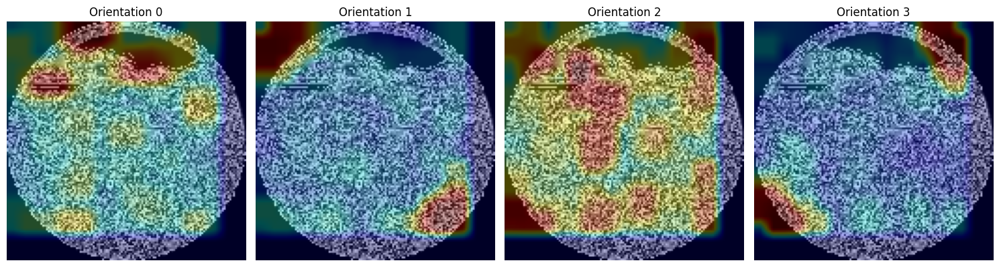

<Figure size 640x480 with 0 Axes>

Image shape: (128, 128)
C1 Activation shape (before resize): (17, 17)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (17, 17)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (17, 17)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (17, 17)
C1 Activation shape (after resize): (128, 128)


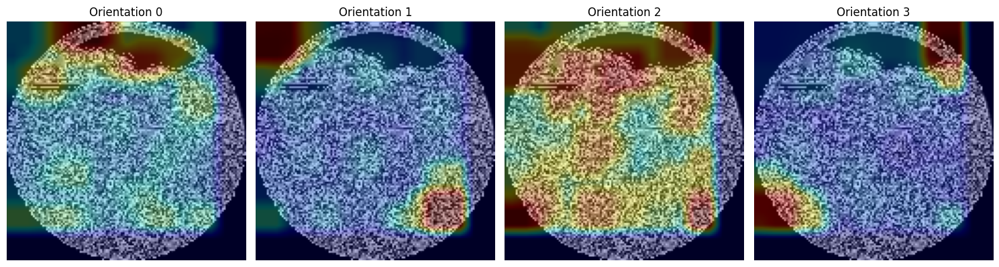

<Figure size 640x480 with 0 Axes>

Image shape: (128, 128)
C1 Activation shape (before resize): (15, 15)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (15, 15)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (15, 15)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (15, 15)
C1 Activation shape (after resize): (128, 128)


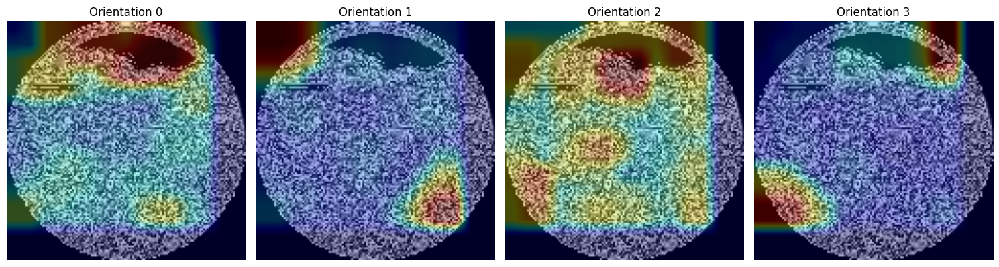

<Figure size 640x480 with 0 Axes>

Image shape: (128, 128)
C1 Activation shape (before resize): (19, 19)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (19, 19)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (19, 19)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (19, 19)
C1 Activation shape (after resize): (128, 128)


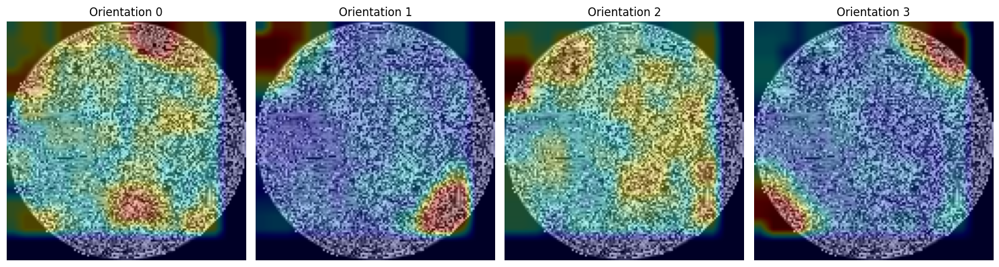

<Figure size 640x480 with 0 Axes>

Image shape: (128, 128)
C1 Activation shape (before resize): (17, 17)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (17, 17)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (17, 17)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (17, 17)
C1 Activation shape (after resize): (128, 128)


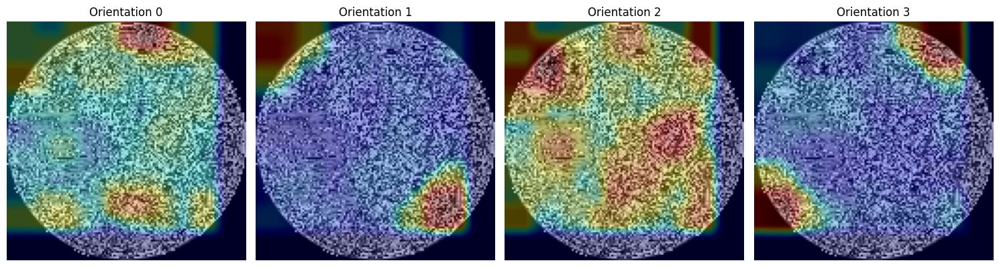

<Figure size 640x480 with 0 Axes>

Image shape: (128, 128)
C1 Activation shape (before resize): (15, 15)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (15, 15)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (15, 15)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (15, 15)
C1 Activation shape (after resize): (128, 128)


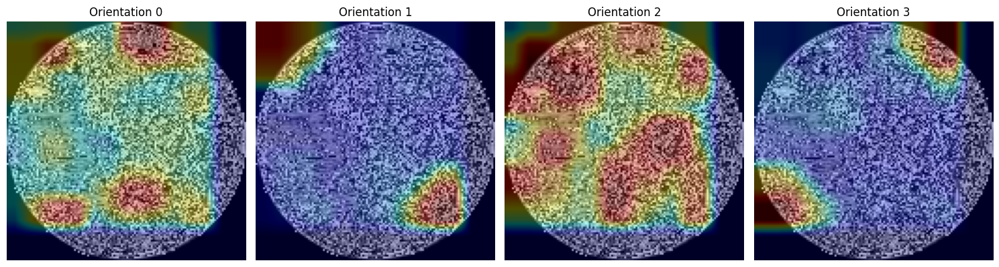

<Figure size 640x480 with 0 Axes>

Image shape: (128, 128)
C1 Activation shape (before resize): (19, 19)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (19, 19)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (19, 19)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (19, 19)
C1 Activation shape (after resize): (128, 128)


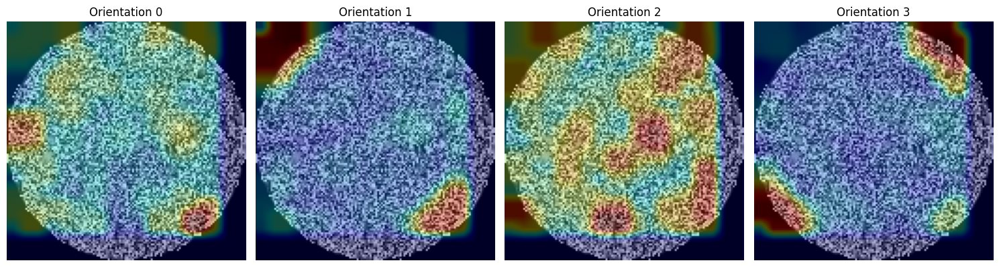

<Figure size 640x480 with 0 Axes>

Image shape: (128, 128)
C1 Activation shape (before resize): (17, 17)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (17, 17)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (17, 17)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (17, 17)
C1 Activation shape (after resize): (128, 128)


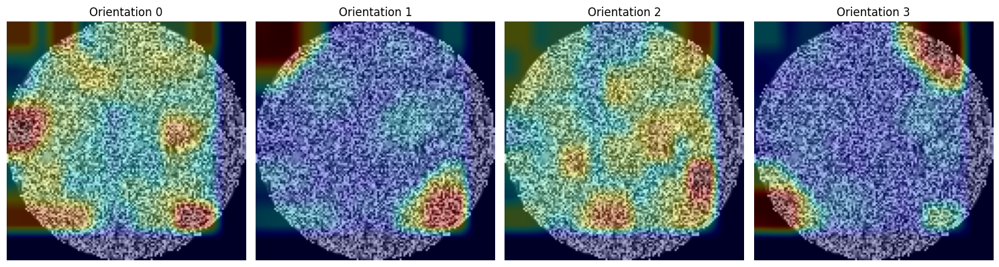

<Figure size 640x480 with 0 Axes>

Image shape: (128, 128)
C1 Activation shape (before resize): (15, 15)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (15, 15)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (15, 15)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (15, 15)
C1 Activation shape (after resize): (128, 128)


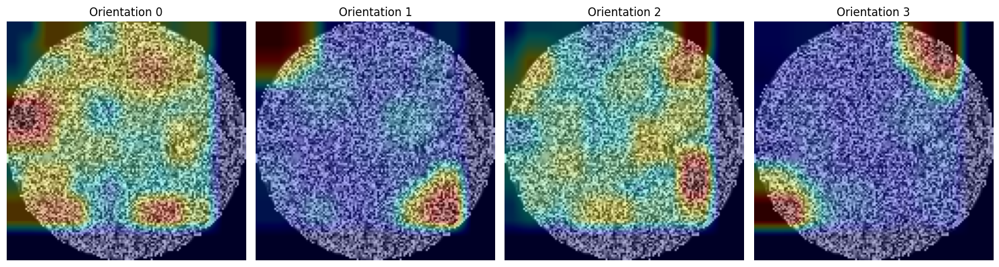

<Figure size 640x480 with 0 Axes>

Image shape: (128, 128)
C1 Activation shape (before resize): (19, 19)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (19, 19)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (19, 19)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (19, 19)
C1 Activation shape (after resize): (128, 128)


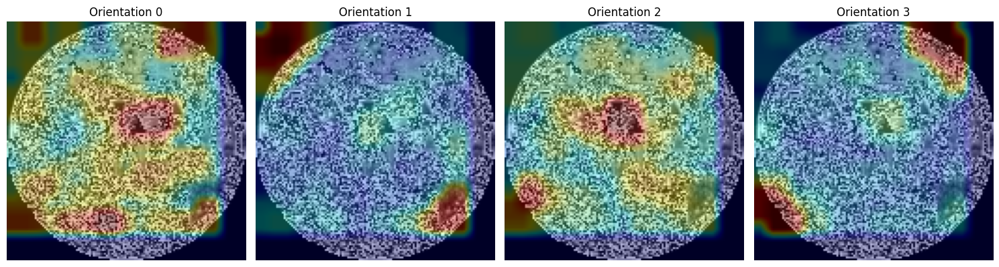

<Figure size 640x480 with 0 Axes>

Image shape: (128, 128)
C1 Activation shape (before resize): (17, 17)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (17, 17)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (17, 17)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (17, 17)
C1 Activation shape (after resize): (128, 128)


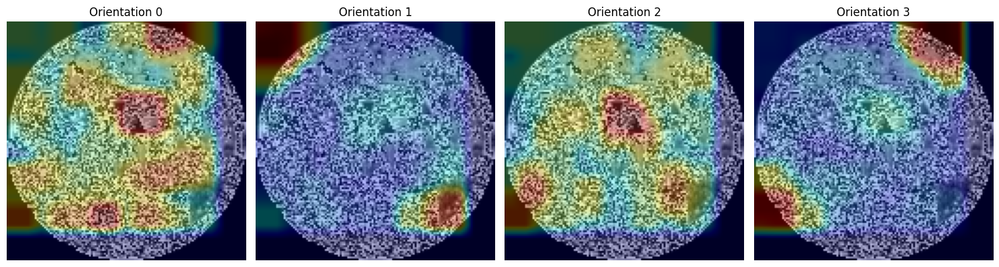

<Figure size 640x480 with 0 Axes>

Image shape: (128, 128)
C1 Activation shape (before resize): (15, 15)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (15, 15)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (15, 15)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (15, 15)
C1 Activation shape (after resize): (128, 128)


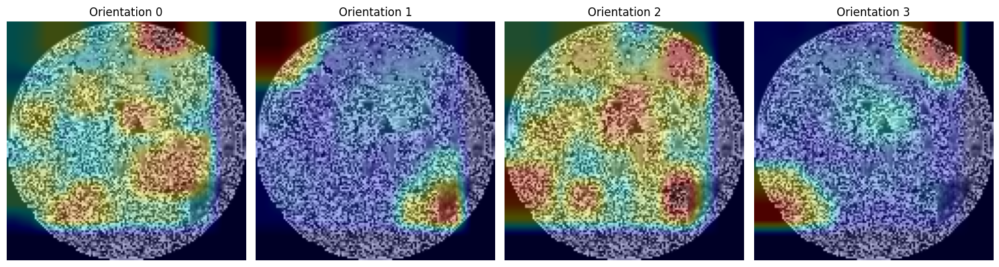

<Figure size 640x480 with 0 Axes>

Image shape: (128, 128)
C1 Activation shape (before resize): (19, 19)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (19, 19)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (19, 19)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (19, 19)
C1 Activation shape (after resize): (128, 128)


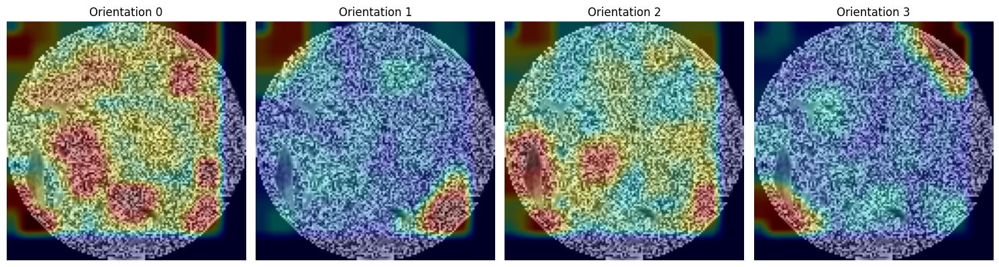

<Figure size 640x480 with 0 Axes>

Image shape: (128, 128)
C1 Activation shape (before resize): (17, 17)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (17, 17)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (17, 17)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (17, 17)
C1 Activation shape (after resize): (128, 128)


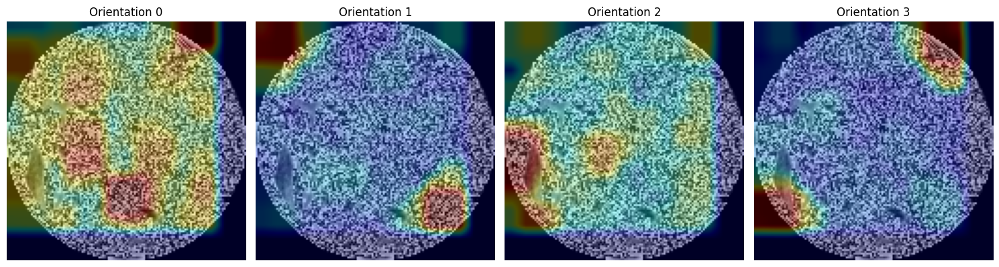

<Figure size 640x480 with 0 Axes>

Image shape: (128, 128)
C1 Activation shape (before resize): (15, 15)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (15, 15)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (15, 15)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (15, 15)
C1 Activation shape (after resize): (128, 128)


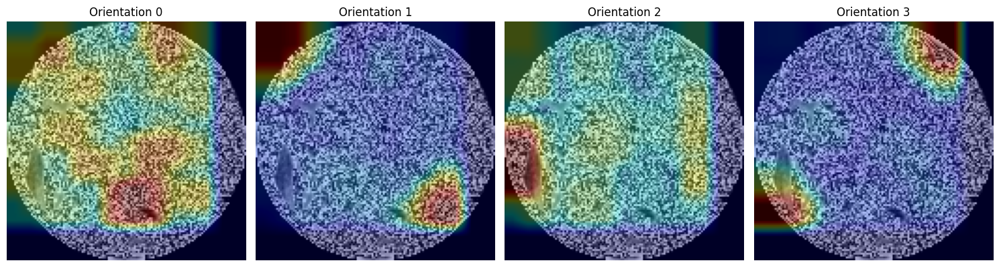

<Figure size 640x480 with 0 Axes>

Image shape: (128, 128)
C1 Activation shape (before resize): (19, 19)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (19, 19)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (19, 19)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (19, 19)
C1 Activation shape (after resize): (128, 128)


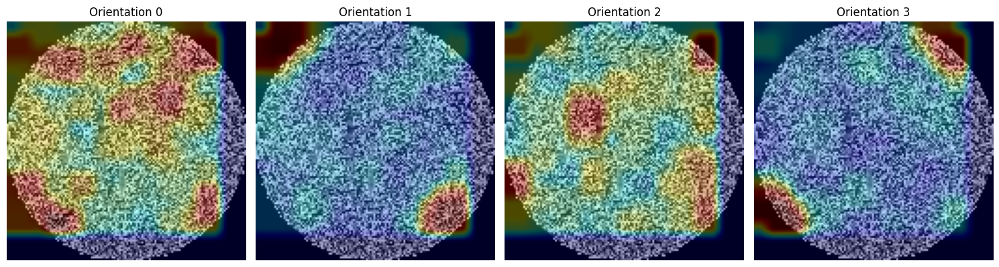

<Figure size 640x480 with 0 Axes>

Image shape: (128, 128)
C1 Activation shape (before resize): (17, 17)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (17, 17)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (17, 17)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (17, 17)
C1 Activation shape (after resize): (128, 128)


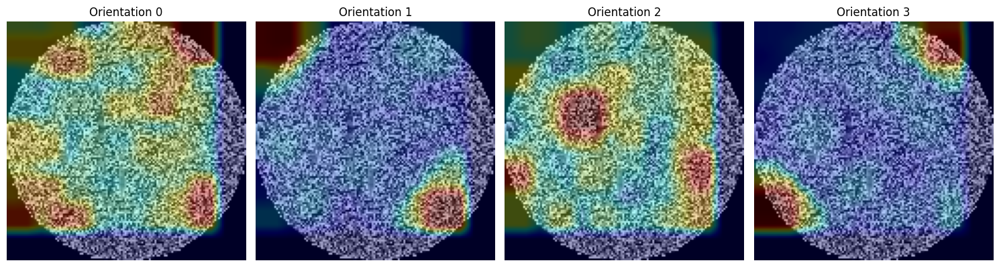

<Figure size 640x480 with 0 Axes>

Image shape: (128, 128)
C1 Activation shape (before resize): (15, 15)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (15, 15)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (15, 15)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (15, 15)
C1 Activation shape (after resize): (128, 128)


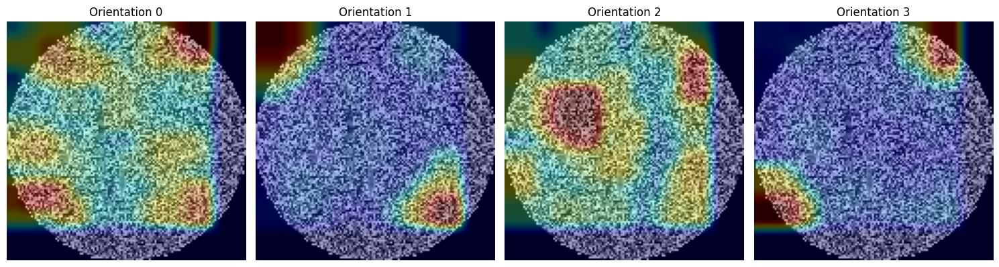

<Figure size 640x480 with 0 Axes>

Image shape: (128, 128)
C1 Activation shape (before resize): (19, 19)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (19, 19)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (19, 19)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (19, 19)
C1 Activation shape (after resize): (128, 128)


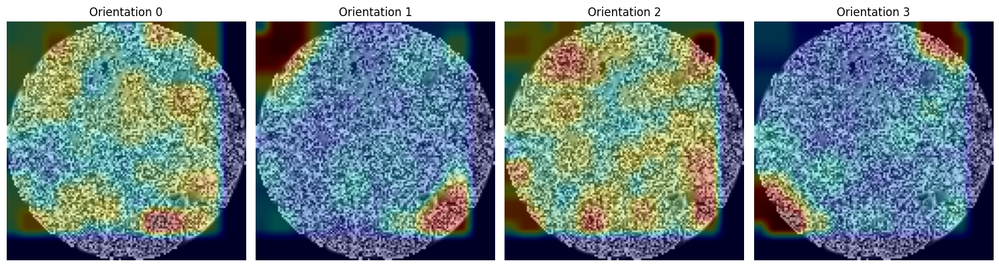

<Figure size 640x480 with 0 Axes>

Image shape: (128, 128)
C1 Activation shape (before resize): (17, 17)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (17, 17)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (17, 17)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (17, 17)
C1 Activation shape (after resize): (128, 128)


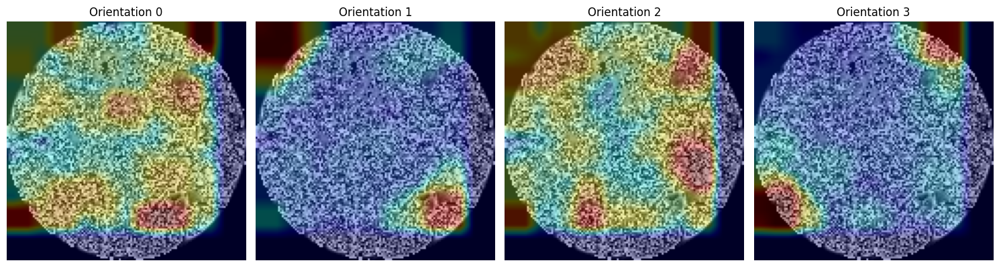

<Figure size 640x480 with 0 Axes>

Image shape: (128, 128)
C1 Activation shape (before resize): (15, 15)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (15, 15)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (15, 15)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (15, 15)
C1 Activation shape (after resize): (128, 128)


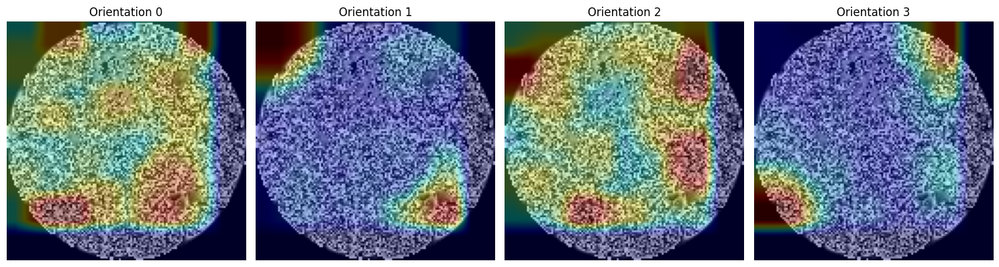

<Figure size 640x480 with 0 Axes>

Image shape: (128, 128)
C1 Activation shape (before resize): (19, 19)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (19, 19)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (19, 19)
C1 Activation shape (after resize): (128, 128)
Image shape: (128, 128, 3)
C1 Activation shape (before resize): (19, 19)
C1 Activation shape (after resize): (128, 128)
Buffered data was truncated after reaching the output size limit.

In [ ]:
import torch
from torch.utils.data import DataLoader, TensorDataset
import numpy as np
import matplotlib.pyplot as plt
from scipy.io import loadmat
from torchvision import transforms
from google.colab import drive
import os
from scipy.spatial.distance import pdist, squareform
import cv2

# Mount Google Drive
drive.mount('/content/drive')

def visualize_c1_on_image(img_tensor, c1_outputs):
    """Visualizes C1 activations overlaid on the input image."""
    img = (img_tensor[0, 0].cpu().numpy() * 255).astype(np.uint8)  # Convert to uint8 for OpenCV

    num_orientations = c1_outputs.shape[1]
    fig, axes = plt.subplots(nrows=1, ncols=num_orientations, figsize=(15, 5))

    for i in range(num_orientations):
        # Resize C1 activations to match image size (if needed)
        print("Image shape:", img.shape)
        print("C1 Activation shape (before resize):", c1_outputs[0, i].shape)
        c1_resized = cv2.resize(c1_outputs[0, i], (img.shape[1], img.shape[0]))
        print("C1 Activation shape (after resize):", c1_resized.shape)
        if len(img.shape) == 2:  # If image is grayscale, convert to 3 channels
          img = cv2.cvtColor(img, cv2.COLOR_GRAY2BGR)

        # Normalize activations for display
        c1_heatmap = cv2.normalize(c1_resized, None, 255,0, cv2.NORM_MINMAX, cv2.CV_8U)
        c1_heatmap = cv2.applyColorMap(c1_heatmap, cv2.COLORMAP_JET)
        if c1_heatmap.shape[2] == 1:
          c1_heatmap = cv2.cvtColor(c1_heatmap, cv2.COLOR_GRAY2BGR)
        # Blend image and heatmap
        overlayed_img = cv2.addWeighted(img, 0.7, c1_heatmap, 0.3, 0)

        axes[i].imshow(overlayed_img[:,:,::-1])  # OpenCV uses BGR, so reverse to RGB
        axes[i].set_title(f"Orientation {i}")
        axes[i].axis('off')

    plt.tight_layout()
    plt.show()

def plot_dissimilarity_matrix(dissimilarity_matrix):
    plt.imshow(dissimilarity_matrix, cmap='viridis')
    plt.colorbar()
    plt.title('Dissimilarity Matrix')
    plt.xlabel('Image Index')
    plt.ylabel('Image Index')
    plt.show()

universal_patch_set_path = '/content/drive/My Drive/Hmax_Dep/universal_patch_set.mat'

if not os.path.exists(universal_patch_set_path):
    raise FileNotFoundError(f"The file {universal_patch_set_path} does not exist. Please check the path.")

print('Constructing model')
model = HMAX(universal_patch_set_path)

# Assuming stimuli is your dataset of images
X_train_tensor = torch.from_numpy(np.stack(stimuli)).float()
# Add a channel dimension if missing
if len(X_train_tensor.shape) == 3:  # [batch_size, height, width]
    X_train_tensor = X_train_tensor.unsqueeze(1)  # [batch_size, 1, height, width]

dataset = TensorDataset(X_train_tensor)

# Prepare the data loader
dataloader = DataLoader(dataset, batch_size=1, shuffle=False)

# Move model to GPU if available
device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')
print('Running model on', device)
model = model.to(device)

# Define a list to store the features from all images
c1_features_all = []

# Transformations to be applied to each image
transform = transforms.Compose([
    transforms.ToPILImage(),
    transforms.ToTensor(),
    transforms.Lambda(lambda x: x * 255),
])

# Process each image in X_train
frames = []
for image in X_train:
    image = transform(image)
    frames.append(image)

# Create a DataLoader
dataloader = DataLoader(frames, batch_size=1)

for i, X in enumerate(dataloader):
    X = X.to(device)
    if len(X.shape) == 3:  # Add channel dimension if missing
        X = X.unsqueeze(1)

    # Get all layers from the model
    s1, c1 = model.get_all_layers(X)

    # Initialize a list to store the concatenated features for the current image
    concatenated_features = []

    # Iterate over selected scales, e.g., c1[3], c1[4], c1[5]
    for scale_index in range(3, 6):  # Adjust range as needed
        # Extract C1 activations for the current scale
        c1_activations = c1[scale_index]

        # Flatten the C1 activations
        flattened_c1 = c1_activations.flatten()

        # Append the flattened features to the list for the current image
        concatenated_features.append(flattened_c1)

        # Optionally visualize the activations
        visualize_c1_on_image(X.cpu().detach(), c1_activations)
        plt.suptitle(f"C1 Activations on Image - Scale {scale_index + 1}")
        plt.show()

    # Concatenate all features for the current image across selected scales
    concatenated_features = np.concatenate(concatenated_features)

    # Append the features for the current image to the list of all images
    c1_features_all.append(concatenated_features)

# Convert the list of features for all images to a NumPy array
c1_features_all = np.array(c1_features_all)

# Compute the dissimilarity matrix using Euclidean distance
dissimilarity_matrix = squareform(pdist(c1_features_all, metric='euclidean'))

# Plot the dissimilarity matrix
plot_dissimilarity_matrix(dissimilarity_matrix)

In [ ]:
#Save dissimilarity matrix to as a dataframe
np.save('dissimilarity_matrix.npy', dissimilarity_matrix)


In [ ]:
import pandas as pd
dissimilarity_matrix_df = pd.DataFrame(dissimilarity_matrix)
dissimilarity_matrix_df.to_csv('dissimilarity_matrix.csv', index=False)

Shape of first_image: (128, 128)
Data type of first_image: uint8


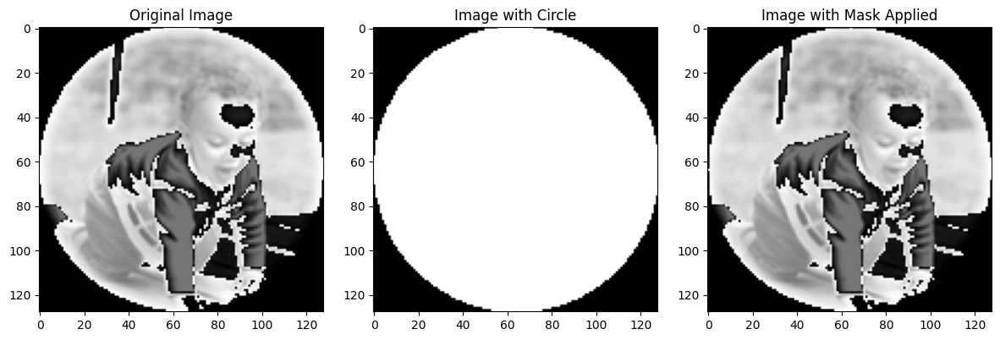

In [71]:
import numpy as np
import cv2
from matplotlib import pyplot as plt

# Example setup (replace with your actual data loading)
# X_train = [np.random.randint(0, 256, (100, 100), dtype=np.uint8)]

first_image = X_train[0]
first_image = first_image.astype(np.uint8)

# Ensure the image is contiguous
first_image = np.ascontiguousarray(first_image)

print("Shape of first_image:", first_image.shape)
print("Data type of first_image:", first_image.dtype)

# Calculate the center and the radius
center_x, center_y = first_image.shape[1] // 2, first_image.shape[0] // 2
radius = min(center_x, center_y)

# Draw the circle on a copy of the image
first_image_copy = first_image.copy()

# Check if the image is grayscale or color for correct color value in cv2.circle
if len(first_image.shape) == 2:
    color_value = 255  # Grayscale
else:
    color_value = (255, 255, 255)  # Color

cv2.circle(first_image_copy, (center_x, center_y), radius, color_value, -1)

# Create a mask
mask = np.zeros(first_image.shape, dtype=np.uint8)
cv2.circle(mask, (center_x, center_y), radius, 255, -1)

# Check if we need to expand dimensions for the mask application
if len(first_image.shape) == 3 and mask.ndim == 2:
    mask = np.repeat(mask[:, :, np.newaxis], 3, axis=2)

# Apply the mask
masked_image = cv2.bitwise_and(first_image, first_image, mask=mask[:, :, 0] if mask.ndim == 3 else mask)

# Display the images
plt.figure(figsize=(12, 6))

plt.subplot(1, 3, 1)
plt.imshow(first_image, cmap='gray')
plt.title("Original Image")

plt.subplot(1, 3, 2)
plt.imshow(first_image_copy, cmap='gray')
plt.title("Image with Circle")

plt.subplot(1, 3, 3)
plt.imshow(masked_image, cmap='gray')
plt.title("Image with Mask Applied")

plt.tight_layout()
plt.show()


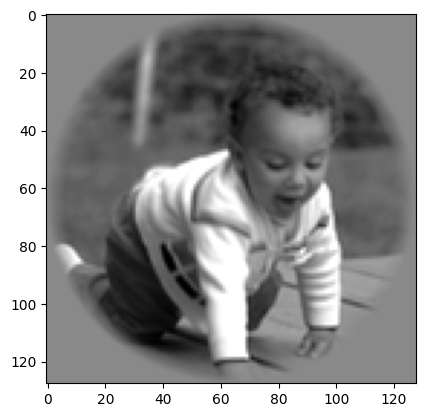

In [73]:
plt.imshow(X_train[0], cmap='gray')